In [1]:
import matplotlib.pyplot as plt
import seaborn           as sn
import numpy             as np
import pandas            as pd
import skimage.filters   as flt
import skimage.io        as io
import matplotlib        as mpl

from sklearn.cluster     import KMeans
from sklearn.neighbors   import KNeighborsClassifier
from sklearn.metrics     import confusion_matrix
from sklearn.datasets    import make_blobs

from matplotlib.colors   import ListedColormap
from matplotlib.patches  import Ellipse
from lecturesupport      import plotsupport as ps

import scipy.stats       as stats
import astropy.io.fits   as fits

import keras.metrics     as metrics
import keras.losses      as loss
import keras.optimizers  as opt
from keras.models        import Model
from keras.layers        import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate

%matplotlib inline


from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg', 'png')
#plt.style.use('seaborn')
mpl.rcParams['figure.dpi'] = 300

Using TensorFlow backend.


In [2]:
import importlib
importlib.reload(ps);

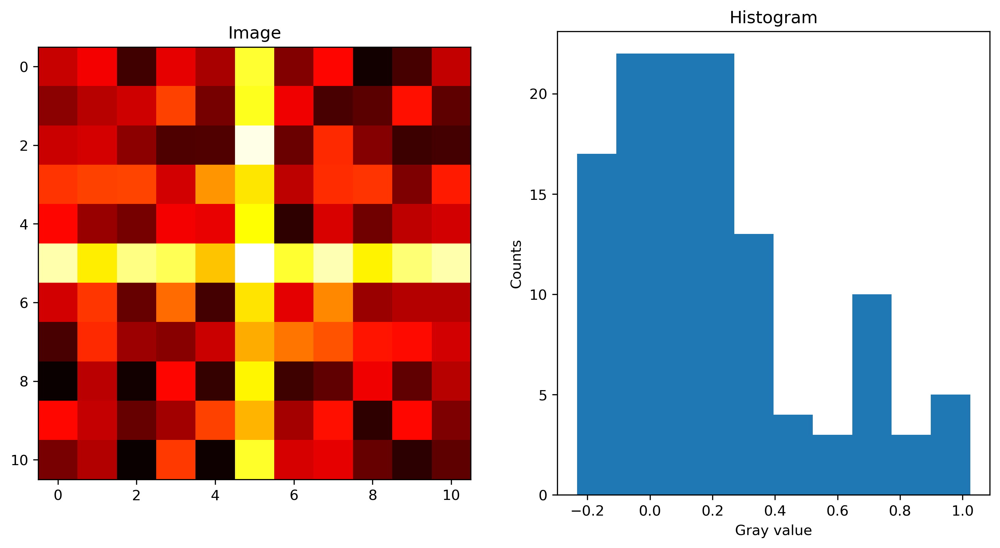

In [3]:
fig,ax = plt.subplots(1,2,figsize=(12,6))
nx = 5; ny = 5;
# Create the test image
xx, yy   = np.meshgrid(np.arange(-nx, nx+1)/nx*2*np.pi, np.arange(-ny, ny+1)/ny*2*np.pi)
cross_im = 1.5*np.abs(np.cos(xx*yy))/(np.abs(xx*yy)+(3*np.pi/nx)) + np.random.uniform(-0.25, 0.25, size = xx.shape)       

# Show it
im=ax[0].imshow(cross_im, cmap = 'hot'); ax[0].set_title("Image")
ax[1].hist(cross_im.ravel(),bins=10); ax[1].set_xlabel('Gray value'); ax[1].set_ylabel('Counts'); ax[1].set_title("Histogram");

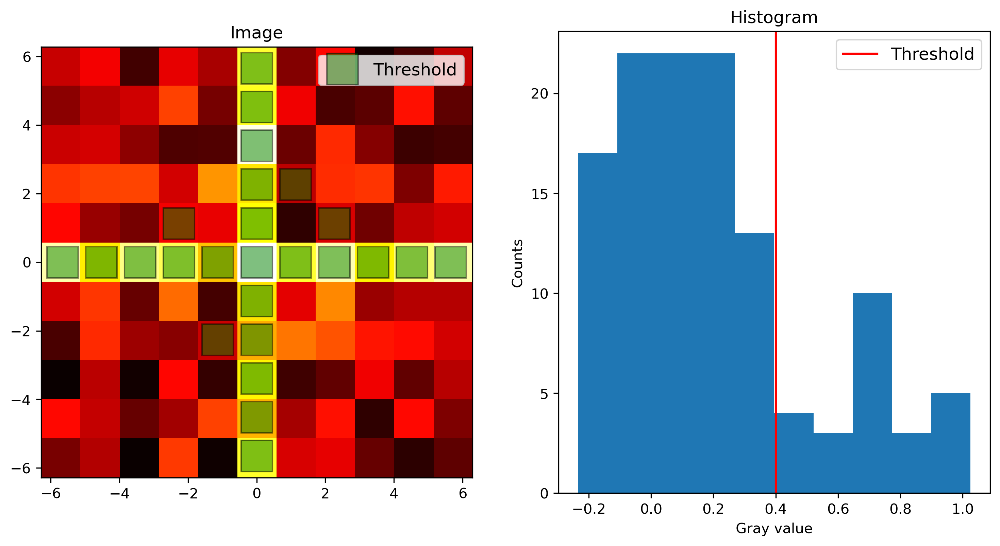

In [4]:
threshold = 0.4; thresh_img = cross_im > threshold
fig,ax = plt.subplots(1,2,figsize=(12,6))
ax[0].imshow(cross_im, cmap = 'hot', extent = [xx.min(), xx.max(), yy.min(), yy.max()]); ax[0].set_title("Image")
ax[0].plot(xx[np.where(thresh_img)]*0.9, yy[np.where(thresh_img)]*0.9,
           'ks', markerfacecolor = 'green', alpha = 0.5,label = 'Threshold', markersize = 22); ax[0].legend(fontsize=12);
ax[1].hist(cross_im.ravel(),bins=10); ax[1].axvline(x=threshold,color='r',label='Threshold'); ax[1].legend(fontsize=12); 
ax[1].set_xlabel('Gray value'); ax[1].set_ylabel('Counts'); ax[1].set_title("Histogram");

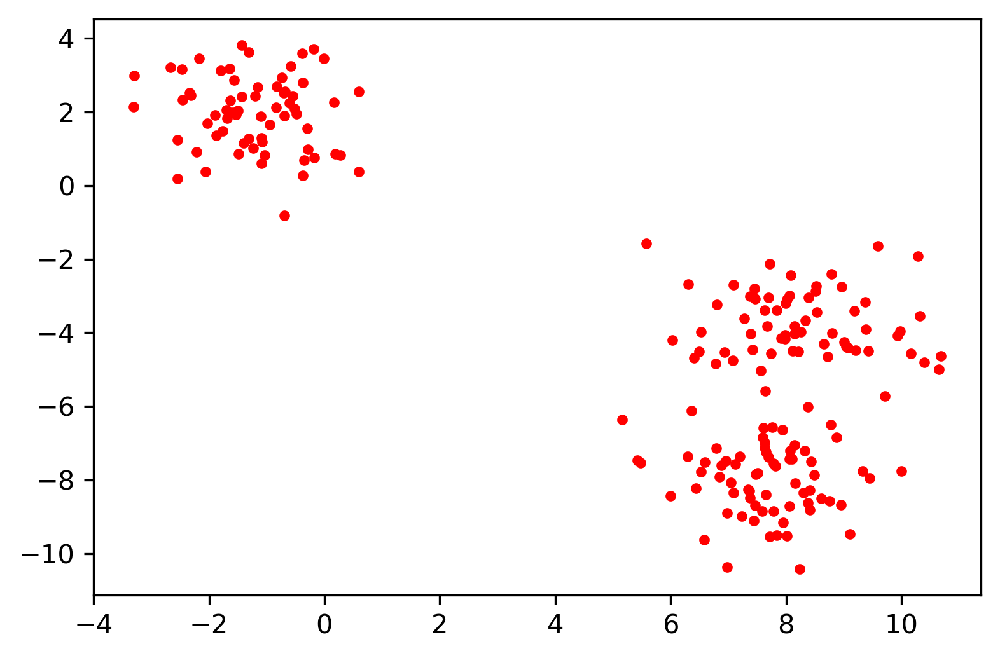

In [5]:
test_pts = pd.DataFrame(make_blobs(n_samples=200, random_state=2018)[
                        0], columns=['x', 'y'])
plt.plot(test_pts.x, test_pts.y, 'r.');

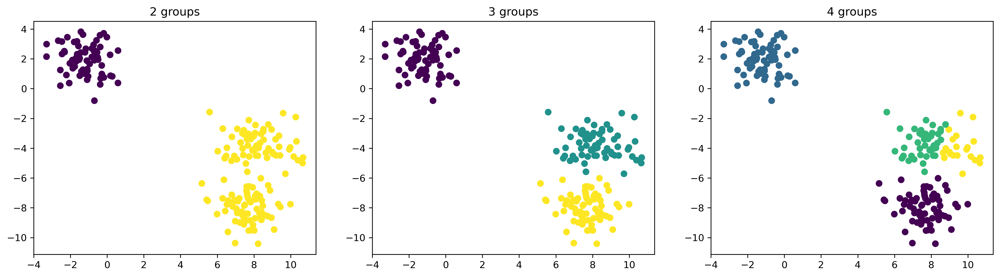

In [6]:
N=3
fig, ax = plt.subplots(1,N,figsize=(18,4.5))

for i in range(N) :
    km = KMeans(n_clusters=i+2, random_state=2018); n_grp = km.fit_predict(test_pts)
    ax[i].scatter(test_pts.x, test_pts.y, c=n_grp)
    ax[i].set_title('{0} groups'.format(i+2))

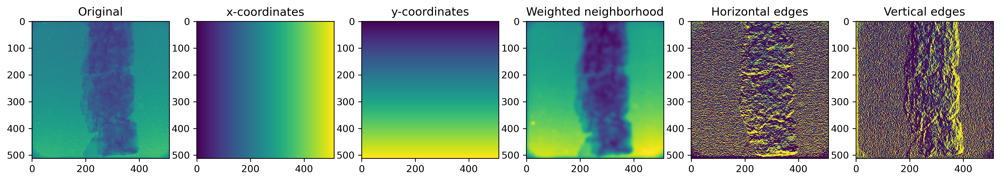

In [7]:
orig = fits.getdata('../data/spots/mixture12_00001.fits')[::4,::4]
fig,ax = plt.subplots(1,6,figsize=(18,5)); x,y = np.meshgrid(np.linspace(0,1,orig.shape[0]),np.linspace(0,1,orig.shape[1]))
ax[0].imshow(orig, vmin=0, vmax=4000), ax[0].set_title('Original')
ax[1].imshow(x), ax[1].set_title('x-coordinates')
ax[2].imshow(y), ax[2].set_title('y-coordinates')
ax[3].imshow(flt.gaussian(orig, sigma=5)), ax[3].set_title('Weighted neighborhood')
ax[4].imshow(flt.sobel_h(orig),vmin=0, vmax=0.001),ax[4].set_title('Horizontal edges')
ax[5].imshow(flt.sobel_v(orig),vmin=0, vmax=0.001),ax[5].set_title('Vertical edges');

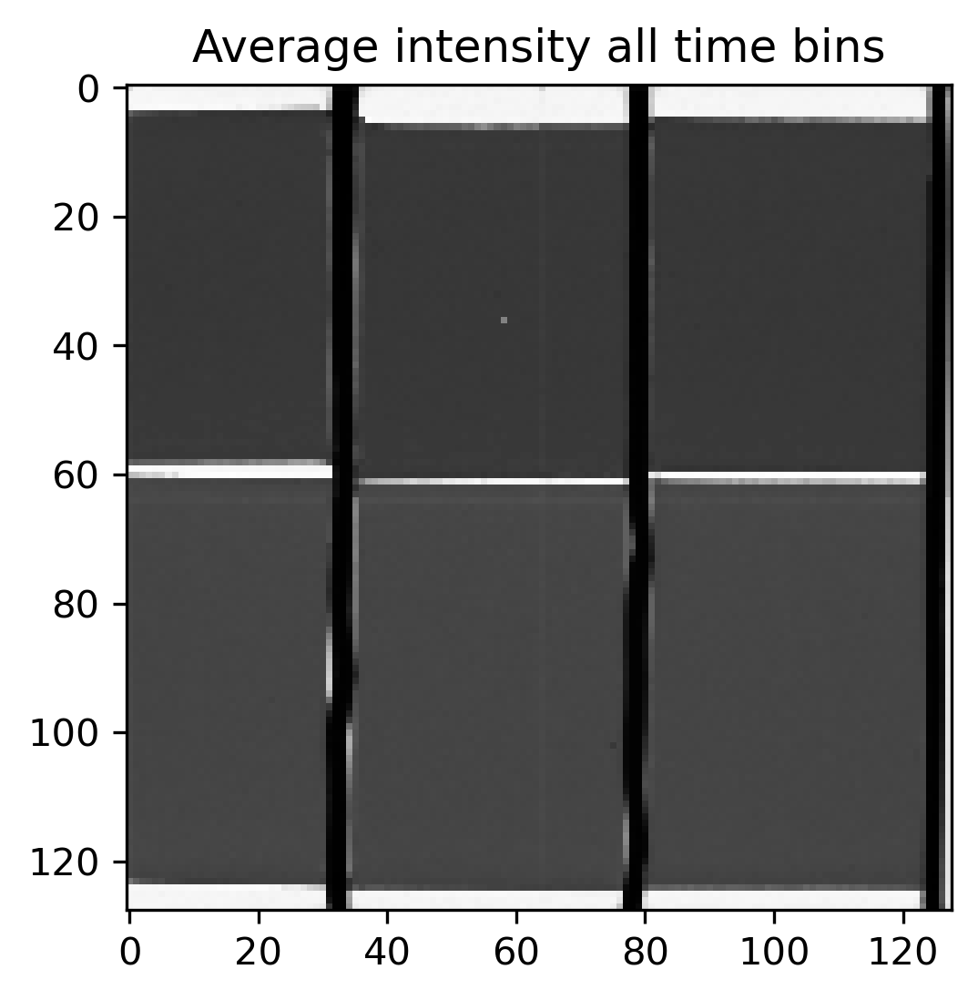

In [8]:
tof  = np.load('../data/tofdata.npy')
wtof = tof.mean(axis=2)
plt.imshow(wtof,cmap='gray'); 
plt.title('Average intensity all time bins');

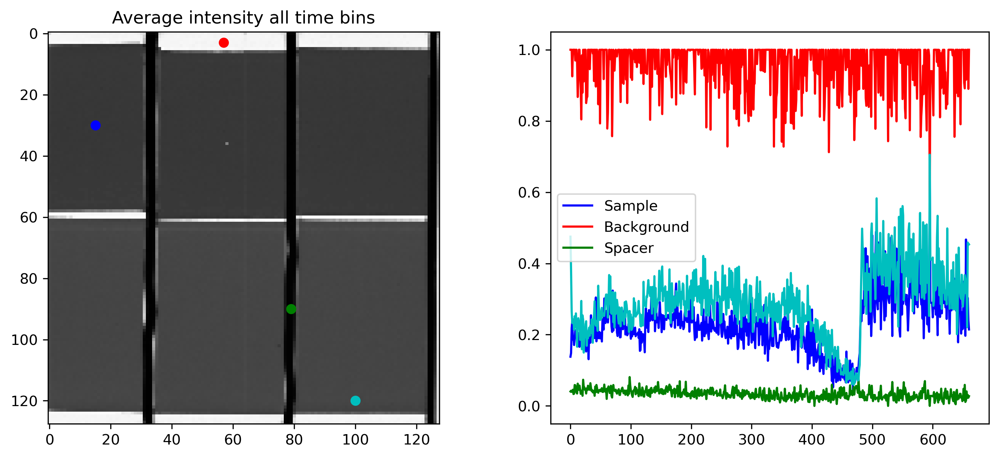

In [9]:
fig, ax= plt.subplots(1,2,figsize=(12,5))
ax[0].imshow(wtof,cmap='gray'); ax[0].set_title('Average intensity all time bins');
ax[0].plot(57,3,'ro'), ax[0].plot(15,30,'bo'), ax[0].plot(79,90,'go'); ax[0].plot(100,120,'co');
ax[1].plot(tof[30,15,:],'b', label='Sample'); ax[1].plot(tof[3,57,:],'r', label='Background'); ax[1].plot(tof[90,79,:],'g', label='Spacer'); ax[1].legend();ax[1].plot(tof[120,100,:],'c', label='Sample 2');

In [10]:
tofr=tof.reshape([tof.shape[0]*tof.shape[1],tof.shape[2]])
print("Input ToF dimensions",tof.shape)
print("Reshaped ToF data",tofr.shape)

Input ToF dimensions (128, 128, 661)
Reshaped ToF data (16384, 661)


In [11]:
km = KMeans(n_clusters=4, random_state=2018)     # Random state is an initialization parameter for the random number generator
c  = km.fit_predict(tofr).reshape(tof.shape[:2]) # Label image
kc = km.cluster_centers_.transpose()             # cluster centroid spectra

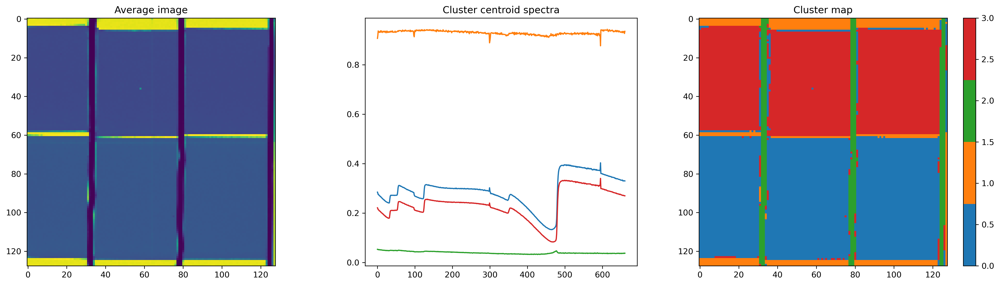

In [12]:
fig,axes = plt.subplots(1,3,figsize=(18,5)); axes=axes.ravel()
axes[0].imshow(wtof,cmap='viridis'); axes[0].set_title('Average image')
p=axes[1].plot(kc);                  axes[1].set_title('Cluster centroid spectra'); axes[1].set_aspect(tof.shape[2], adjustable='box')
cmap=ps.buildCMap(p) # Create a color map with the same colors as the plot

im=axes[2].imshow(c,cmap=cmap); plt.colorbar(im);
axes[2].set_title('Cluster map');
plt.tight_layout()

In [13]:
km = KMeans(n_clusters=10, random_state=2018)
c  = km.fit_predict(tofr).reshape(tof.shape[:2]) # Label image
kc = km.cluster_centers_.transpose()             # cluster centroid spectra

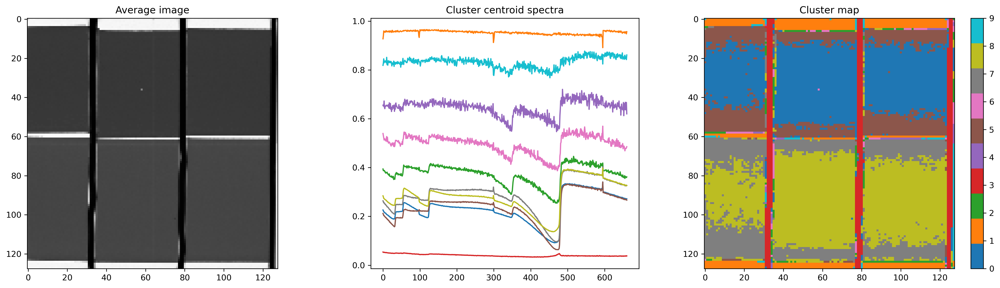

In [14]:
fig,axes = plt.subplots(1,3,figsize=(18,5)); axes=axes.ravel()
axes[0].imshow(wtof,cmap='gray'); axes[0].set_title('Average image')
p=axes[1].plot(kc);                  axes[1].set_title('Cluster centroid spectra'); axes[1].set_aspect(tof.shape[2], adjustable='box')
cmap=ps.buildCMap(p) # Create a color map with the same colors as the plot

im=axes[2].imshow(c,cmap=cmap); plt.colorbar(im);
axes[2].set_title('Cluster map');
plt.tight_layout()

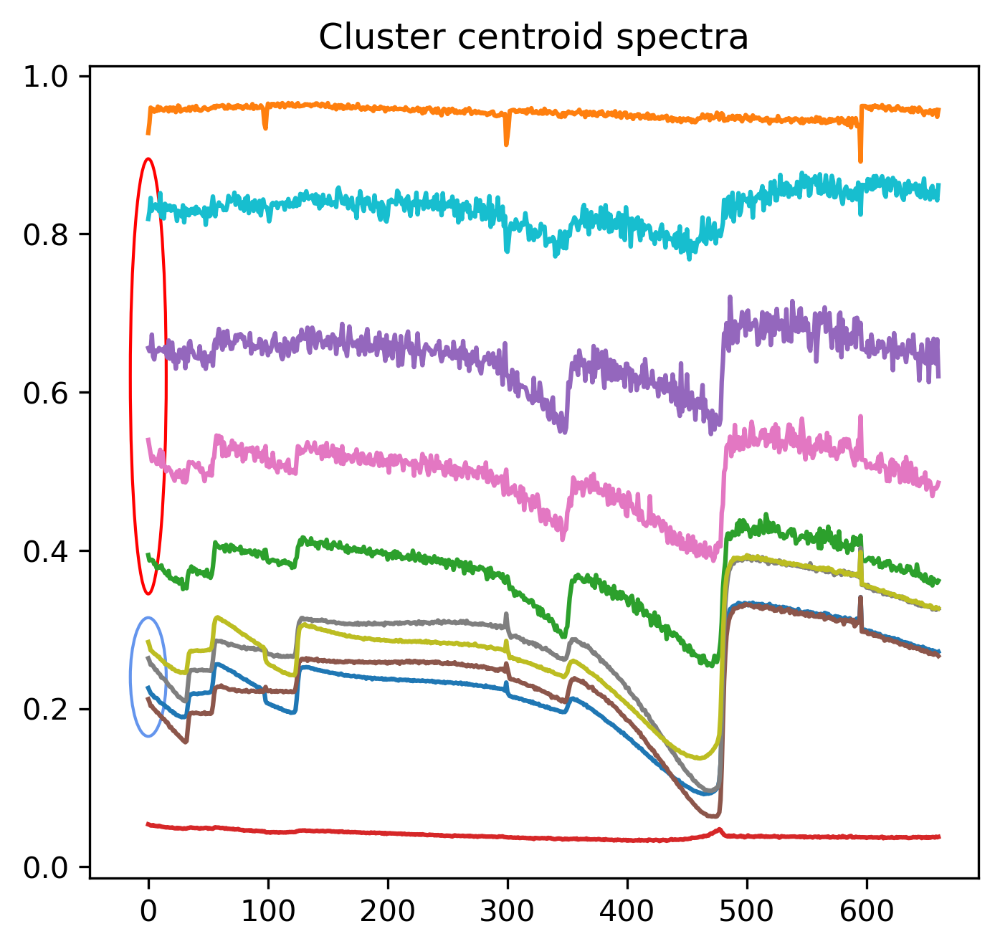

In [15]:
fig,axes = plt.subplots(1,1,figsize=(14,5)); 
plt.plot(kc); axes.set_title('Cluster centroid spectra'); 
axes.add_patch(Ellipse((0,0.62), width=30,height=0.55,fill=False,color='r')) #,axes.set_aspect(tof.shape[2], adjustable='box')
axes.add_patch(Ellipse((0,0.24), width=30,height=0.15,fill=False,color='cornflowerblue')),axes.set_aspect(tof.shape[2], adjustable='box');

In [16]:
del km, c, kc, tofr, tof

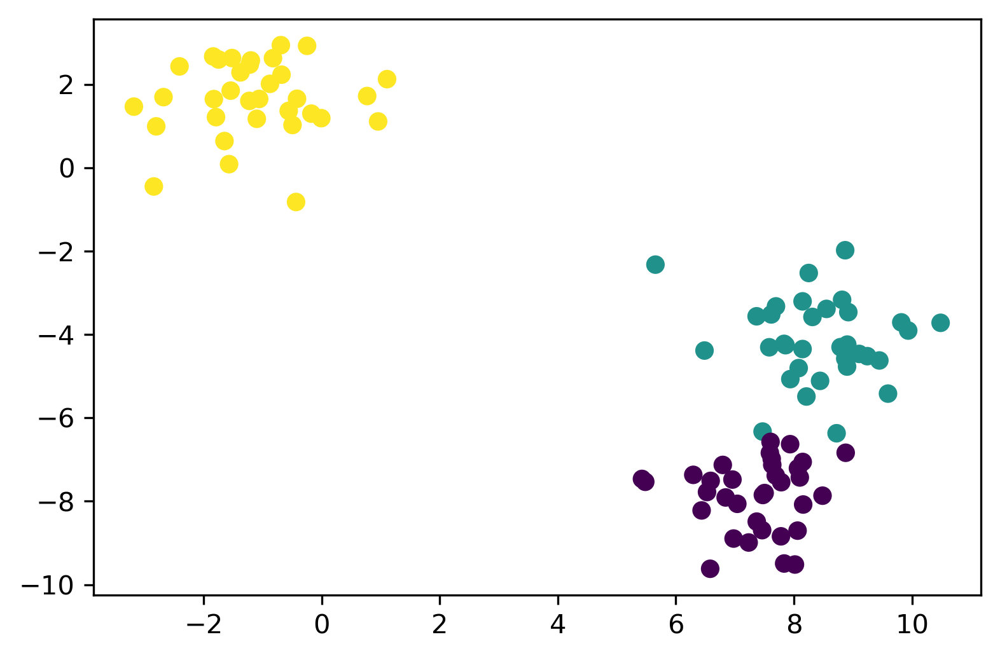

In [17]:
blob_data, blob_labels = make_blobs(n_samples=100, random_state=2018)
test_pts = pd.DataFrame(blob_data, columns=['x', 'y'])
test_pts['group_id'] = blob_labels
plt.scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis');

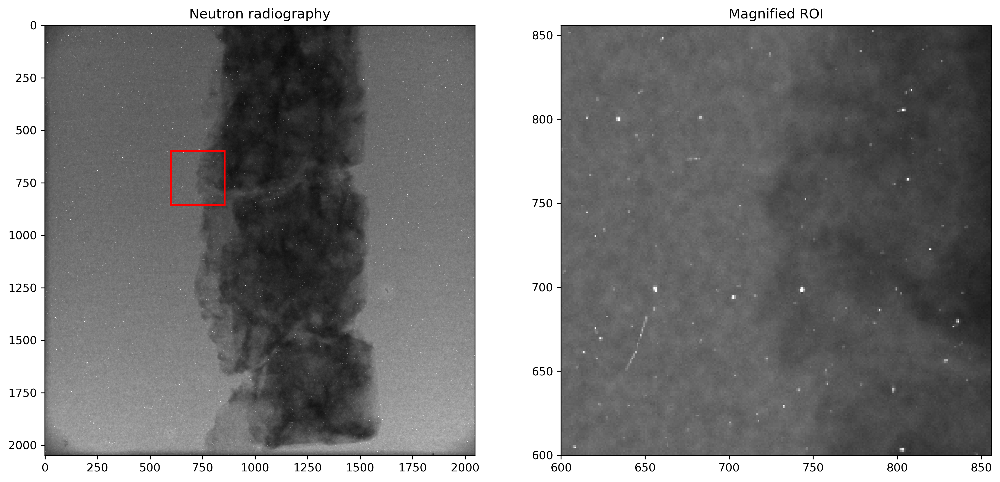

In [18]:
orig= fits.getdata('../data/spots/mixture12_00001.fits')
annotated=io.imread('../data/spots/mixture12_00001.png'); mask=(annotated[:,:,1]==0)
r=600; c=600; w=256
ps.magnifyRegion(orig,[r,c,r+w,c+w],[15,7],vmin=400,vmax=4000,title='Neutron radiography')

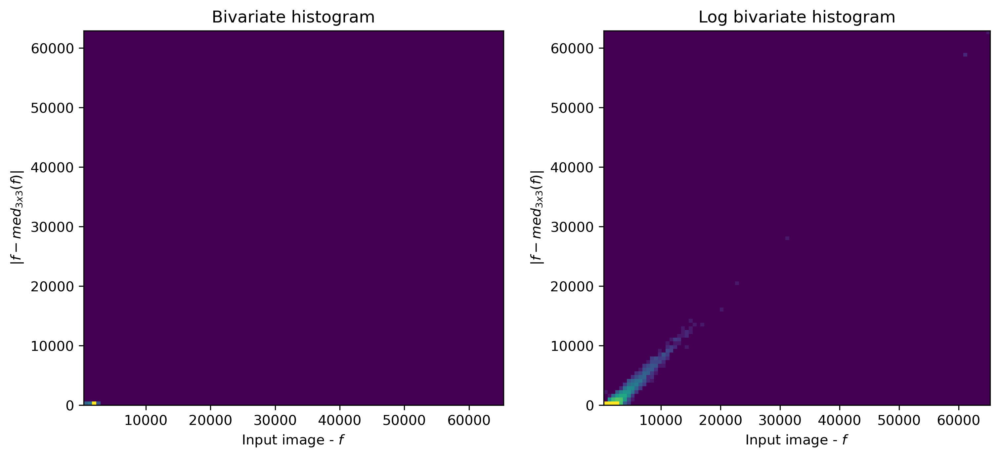

In [19]:
selem=np.ones([3,3])
forig=orig.astype('float32')
mimg = flt.median(forig,selem=selem)
d = np.abs(forig-mimg)

fig,ax=plt.subplots(1,2,figsize=(12,5))
h,x,y,u=ax[0].hist2d(forig.ravel(),d.ravel(), bins=100);
ax[0].set_xlabel('Input image - $f$'),ax[0].set_ylabel('$|f-med_{3x3}(f)|$'),ax[0].set_title('Bivariate histogram');

ax[1].imshow(np.log(h[:,::-1]+1).transpose(),vmin=0,vmax=10,extent=[x.min(),x.max(),y.min(),y.max()])
ax[1].set_xlabel('Input image - $f$'),ax[1].set_ylabel('$|f-med_{3x3}(f)|$'),ax[1].set_title('Log bivariate histogram');

In [20]:
def spotCleaner(img, threshold=0.95, selem=np.ones([3,3])) :
    fimg=img.astype('float32')
    mimg = flt.median(fimg,selem=selem)
    timg = threshold < np.abs(fimg-mimg)
    cleaned = mimg * timg + fimg * (1-timg)
    return (cleaned,timg)

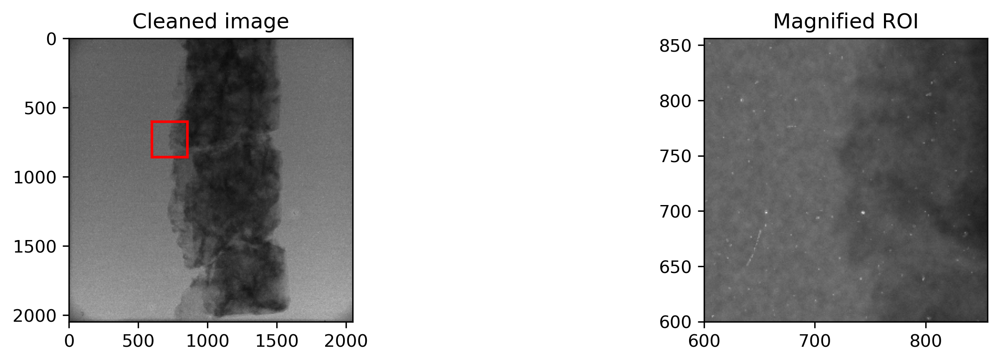

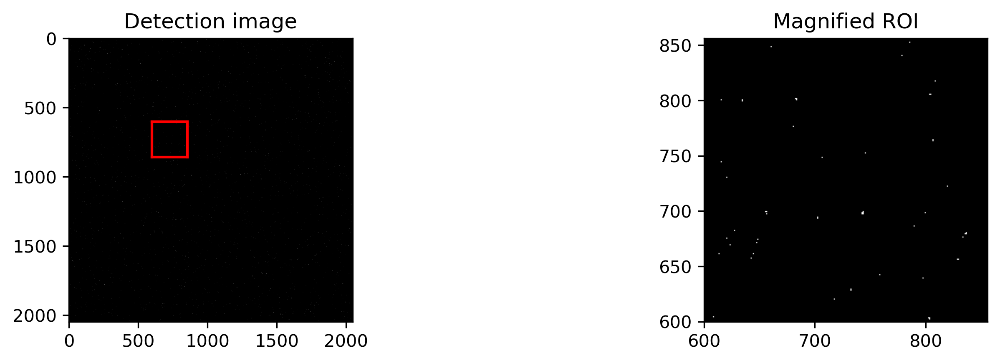

In [21]:
baseclean,timg = spotCleaner(orig,threshold=1000)
ps.magnifyRegion(baseclean,[r,c,r+w,c+w],[12,3],vmin=400,vmax=4000,title='Cleaned image')
ps.magnifyRegion(timg,[r,c,r+w,c+w],[12,3],vmin=0,vmax=1,title='Detection image')

In [22]:
trainorig = forig[:,:1000].ravel()
traind    = d[:,:1000].ravel()
trainmask = mask[:,:1000].ravel()

train_pts = pd.DataFrame({'orig': trainorig, 'd': traind, 'mask':trainmask})

In [23]:
testorig = forig[:,1000:].ravel()
testd    = d[:,1000:].ravel()
testmask = mask[:,1000:].ravel()

test_pts = pd.DataFrame({'orig': testorig, 'd': testd, 'mask':testmask})

In [24]:
k_class = KNeighborsClassifier(1)
k_class.fit(train_pts[['orig', 'd']], train_pts['mask']) 

KNeighborsClassifier(n_neighbors=1)

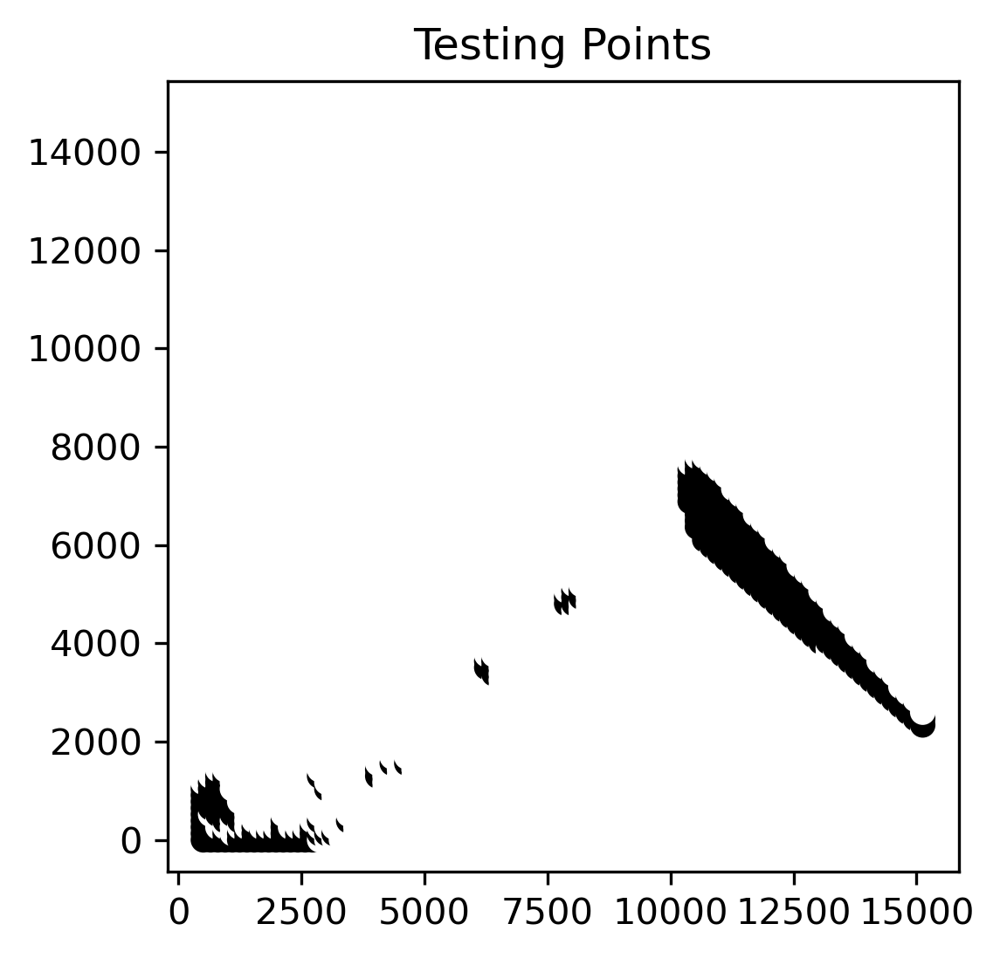

In [25]:
xx, yy = np.meshgrid(np.linspace(test_pts.orig.min(), test_pts.orig.max(), 100),
                     np.linspace(test_pts.d.min(), test_pts.d.max(), 100),indexing='ij');
grid_pts = pd.DataFrame(dict(x=xx.ravel(), y=yy.ravel()))
grid_pts['predicted_id'] = k_class.predict(grid_pts[['x', 'y']])
plt.scatter(grid_pts.x, grid_pts.y, c=grid_pts.predicted_id, cmap='gray'); plt.title('Testing Points'); plt.axis('square');

In [26]:
pred = k_class.predict(test_pts[['orig', 'd']])
pimg = pred.reshape(d[:,1000:].shape)

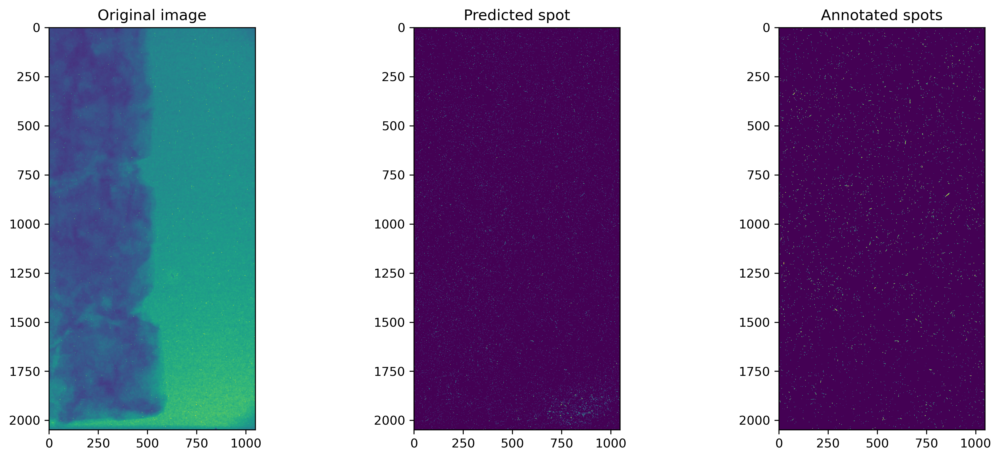

In [27]:
fig,ax = plt.subplots(1,3,figsize=(15,6))
ax[0].imshow(forig[:,1000:],vmin=0,vmax=4000), ax[0].set_title('Original image')
ax[1].imshow(pimg), ax[1].set_title('Predicted spot')
ax[2].imshow(mask[:,1000:]),ax[2].set_title('Annotated spots');

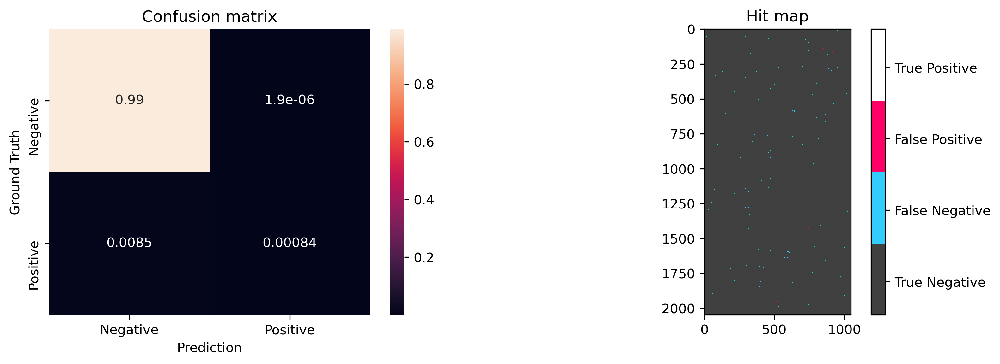

In [28]:
ps.showHitMap(mask[:,1000:],timg[:,1000:])
plt.savefig('spotbaseline.png',dpi=300)

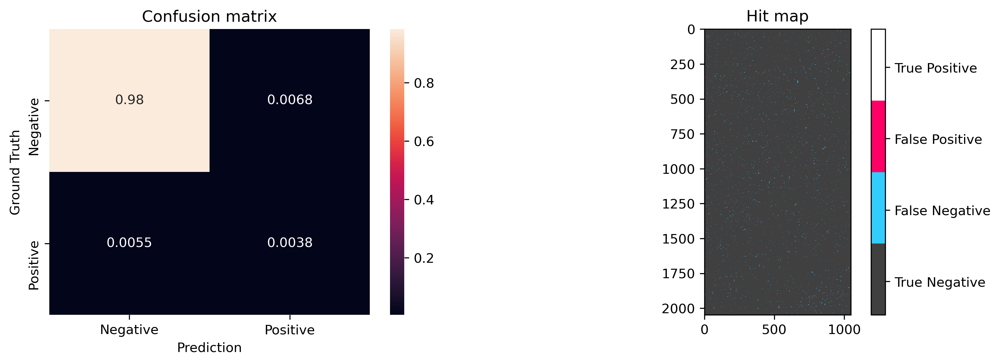

In [29]:
ps.showHitMap(mask[:,1000:], pimg)
plt.savefig('spotknn.png',dpi=300)

In [30]:
del k_class

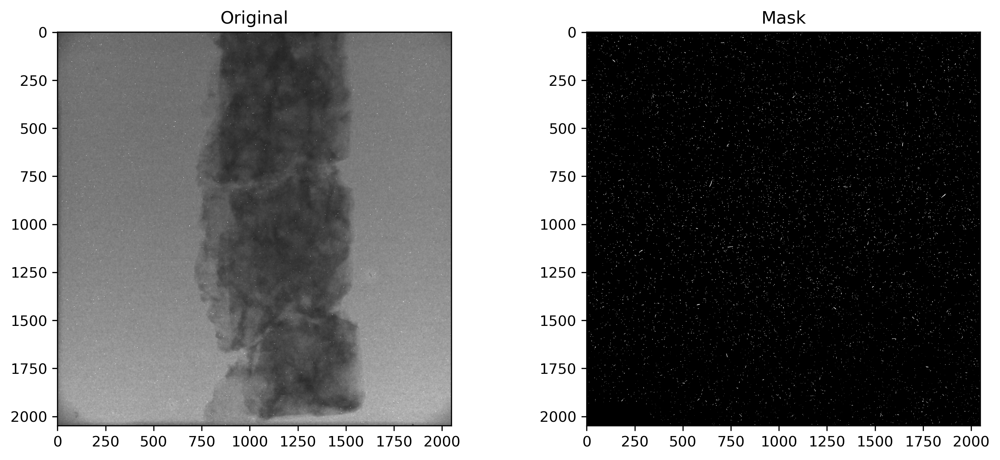

In [31]:
fig,ax=plt.subplots(1,2,figsize=(12,5))
ax[0].imshow(forig,vmin=0,vmax=4000,cmap='gray'); ax[0].set_title('Original');
ax[1].imshow(mask,cmap='gray'); ax[1].set_title('Mask');

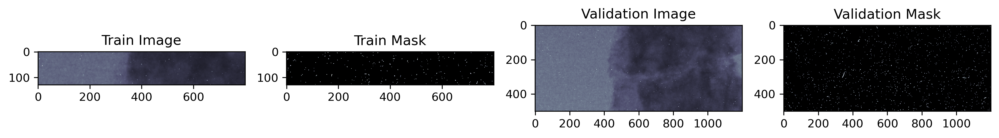

In [32]:
wpos = [600,600]; ww   = 512
train_img,  valid_img, forigc = forig[128:256, 500:1300], forig[500:1000, 300:1500], forig[wpos[0]:(wpos[0]+ww),wpos[1]:(wpos[1]+ww)]
train_mask, valid_mask, maskc = mask[128:256, 500:1300],  mask[500:1000, 300:1500],  mask[wpos[0]:(wpos[0]+ww),wpos[1]:(wpos[1]+ww)]

fig, ax = plt.subplots(1, 4, figsize=(15, 6), dpi=300); ax=ax.ravel()

ax[0].imshow(train_img, cmap='bone',vmin=0,vmax=4000);ax[0].set_title('Train Image')
ax[1].imshow(train_mask, cmap='bone'); ax[1].set_title('Train Mask')
ax[2].imshow(valid_img, cmap='bone',vmin=0,vmax=4000); ax[2].set_title('Validation Image')
ax[3].imshow(valid_mask, cmap='bone');ax[3].set_title('Validation Mask');

In [33]:
def buildSpotUNet( base_depth = 48) :
    in_img = Input((None, None, 1), name='Image_Input')
    lay_1 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(in_img)
    lay_2 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(lay_1)
    lay_3 = MaxPooling2D(pool_size=(2, 2))(lay_2)
    lay_4 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_3)
    lay_5 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_4)
    lay_6 = MaxPooling2D(pool_size=(2, 2))(lay_5)
    lay_7 = Conv2D(base_depth*4, kernel_size=(3, 3), padding='same',activation='relu')(lay_6)
    lay_8 = Conv2D(base_depth*4, kernel_size=(3, 3), padding='same',activation='relu')(lay_7)
    lay_9 = UpSampling2D((2, 2))(lay_8)
    lay_10 = concatenate([lay_5, lay_9])
    lay_11 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_10)
    lay_12 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_11)
    lay_13 = UpSampling2D((2, 2))(lay_12)
    lay_14 = concatenate([lay_2, lay_13])
    lay_15 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(lay_14)
    lay_16 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(lay_15)
    lay_17 = Conv2D(1, kernel_size=(1, 1), padding='same',
                    activation='relu')(lay_16)
    t_unet = Model(inputs=[in_img], outputs=[lay_17], name='SpotUNET')
    return t_unet

In [34]:
t_unet = buildSpotUNet(base_depth=24)
t_unet.summary()

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


Model: "SpotUNET"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
Image_Input (InputLayer)        (None, None, None, 1 0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, None, None, 2 240         Image_Input[0][0]                
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, None, None, 2 5208        conv2d_1[0][0]                   
__________________________________________________________________________________________________
max_pooling2d_1 (MaxPooling2D)  (None, None, None, 2 0           conv2d_2[0][0]                   
___________________________________________________________________________________________

In [35]:
def prep_img(x, n=1): 
    return (prep_mask(x, n=n)-train_img.mean())/train_img.std()


def prep_mask(x, n=1): 
    return np.stack([np.expand_dims(x, -1)]*n, 0)

In [36]:
unet_pred = t_unet.predict(prep_img(forigc))[0, :, :, 0]

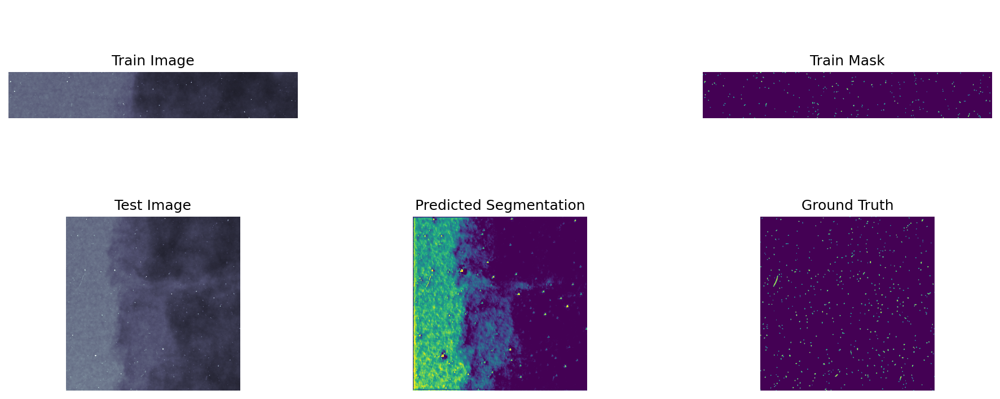

In [37]:
fig, m_axs = plt.subplots(2, 3, figsize=(15, 6), dpi=150)
for c_ax in m_axs.ravel():
    c_ax.axis('off')
((ax1, _, ax2), (ax3, ax4, ax5)) = m_axs
ax1.imshow(train_img, cmap='bone',vmin=0,vmax=4000); ax1.set_title('Train Image')
ax2.imshow(train_mask, cmap='viridis'); ax2.set_title('Train Mask')

ax3.imshow(forigc, cmap='bone',vmin=0, vmax=4000); ax3.set_title('Test Image')
ax4.imshow(unet_pred, cmap='viridis', vmin=0, vmax=0.1); ax4.set_title('Predicted Segmentation')

ax5.imshow(maskc, cmap='viridis'); ax5.set_title('Ground Truth');

In [38]:
mlist = [
      metrics.TruePositives(name='tp'),        metrics.FalsePositives(name='fp'), 
      metrics.TrueNegatives(name='tn'),        metrics.FalseNegatives(name='fn'), 
      metrics.BinaryAccuracy(name='accuracy'), metrics.Precision(name='precision'),
      metrics.Recall(name='recall'),           metrics.AUC(name='auc'),
      metrics.MeanAbsoluteError(name='mae')]

t_unet.compile(
    loss=loss.BinaryCrossentropy(),  # we use the binary cross-entropy to optimize
    optimizer=opt.Adam(lr=1e-3),     # we use ADAM to optimize
    metrics=mlist                    # we keep track of the metrics in mlist
)

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [39]:
Nsamples = 3
loss_history = t_unet.fit(prep_img(train_img, n=Nsamples),
                          prep_mask(train_mask, n=Nsamples),
                          validation_data=(prep_img(valid_img),
                                           prep_mask(valid_mask)),
                          epochs=20,
                          verbose = 2)


Train on 3 samples, validate on 1 samples


Epoch 1/20


 - 10s - loss: 0.0939 - tp: 0.0000e+00 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2544.0000 - accuracy: 0.9917 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.5535 - mae: 0.0263 - val_loss: 0.1188 - val_tp: 4.0000 - val_fp: 2.0000 - val_tn: 593514.0000 - val_fn: 6480.0000 - val_accuracy: 0.9892 - val_precision: 0.6667 - val_recall: 6.1690e-04 - val_auc: 0.6082 - val_mae: 0.0124


Epoch 2/20


 - 7s - loss: 0.0891 - tp: 0.0000e+00 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2544.0000 - accuracy: 0.9917 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.6013 - mae: 0.0105 - val_loss: 0.1035 - val_tp: 7.0000 - val_fp: 8.0000 - val_tn: 593508.0000 - val_fn: 6477.0000 - val_accuracy: 0.9892 - val_precision: 0.4667 - val_recall: 0.0011 - val_auc: 0.6141 - val_mae: 0.0235


Epoch 3/20


 - 7s - loss: 0.0829 - tp: 0.0000e+00 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2544.0000 - accuracy: 0.9917 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.6364 - mae: 0.0276 - val_loss: 0.0934 - val_tp: 7.0000 - val_fp: 12.0000 - val_tn: 593504.0000 - val_fn: 6477.0000 - val_accuracy: 0.9892 - val_precision: 0.3684 - val_recall: 0.0011 - val_auc: 0.6662 - val_mae: 0.0175


Epoch 4/20


 - 7s - loss: 0.0710 - tp: 0.0000e+00 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2544.0000 - accuracy: 0.9917 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.6756 - mae: 0.0181 - val_loss: 0.1014 - val_tp: 7.0000 - val_fp: 4.0000 - val_tn: 593512.0000 - val_fn: 6477.0000 - val_accuracy: 0.9892 - val_precision: 0.6364 - val_recall: 0.0011 - val_auc: 0.7259 - val_mae: 0.0111


Epoch 5/20


 - 7s - loss: 0.0787 - tp: 0.0000e+00 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2544.0000 - accuracy: 0.9917 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.7169 - mae: 0.0087 - val_loss: 0.0706 - val_tp: 19.0000 - val_fp: 23.0000 - val_tn: 593493.0000 - val_fn: 6465.0000 - val_accuracy: 0.9892 - val_precision: 0.4524 - val_recall: 0.0029 - val_auc: 0.7388 - val_mae: 0.0481


Epoch 6/20


 - 7s - loss: 0.0582 - tp: 3.0000 - fp: 6.0000 - tn: 304650.0000 - fn: 2541.0000 - accuracy: 0.9917 - precision: 0.3333 - recall: 0.0012 - auc: 0.7489 - mae: 0.0393 - val_loss: 0.0688 - val_tp: 16.0000 - val_fp: 11.0000 - val_tn: 593505.0000 - val_fn: 6468.0000 - val_accuracy: 0.9892 - val_precision: 0.5926 - val_recall: 0.0025 - val_auc: 0.8356 - val_mae: 0.0118


Epoch 7/20


 - 7s - loss: 0.0543 - tp: 0.0000e+00 - fp: 0.0000e+00 - tn: 304656.0000 - fn: 2544.0000 - accuracy: 0.9917 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.8261 - mae: 0.0092 - val_loss: 0.0520 - val_tp: 31.0000 - val_fp: 23.0000 - val_tn: 593493.0000 - val_fn: 6453.0000 - val_accuracy: 0.9892 - val_precision: 0.5741 - val_recall: 0.0048 - val_auc: 0.8653 - val_mae: 0.0231


Epoch 8/20


 - 7s - loss: 0.0437 - tp: 6.0000 - fp: 9.0000 - tn: 304647.0000 - fn: 2538.0000 - accuracy: 0.9917 - precision: 0.4000 - recall: 0.0024 - auc: 0.8494 - mae: 0.0186 - val_loss: 0.0494 - val_tp: 44.0000 - val_fp: 28.0000 - val_tn: 593488.0000 - val_fn: 6440.0000 - val_accuracy: 0.9892 - val_precision: 0.6111 - val_recall: 0.0068 - val_auc: 0.8930 - val_mae: 0.0244


Epoch 9/20


 - 7s - loss: 0.0414 - tp: 6.0000 - fp: 18.0000 - tn: 304638.0000 - fn: 2538.0000 - accuracy: 0.9917 - precision: 0.2500 - recall: 0.0024 - auc: 0.8812 - mae: 0.0217 - val_loss: 0.0505 - val_tp: 51.0000 - val_fp: 27.0000 - val_tn: 593489.0000 - val_fn: 6433.0000 - val_accuracy: 0.9892 - val_precision: 0.6538 - val_recall: 0.0079 - val_auc: 0.8964 - val_mae: 0.0141


Epoch 10/20


 - 6s - loss: 0.0400 - tp: 12.0000 - fp: 18.0000 - tn: 304638.0000 - fn: 2532.0000 - accuracy: 0.9917 - precision: 0.4000 - recall: 0.0047 - auc: 0.8790 - mae: 0.0131 - val_loss: 0.0464 - val_tp: 58.0000 - val_fp: 34.0000 - val_tn: 593482.0000 - val_fn: 6426.0000 - val_accuracy: 0.9892 - val_precision: 0.6304 - val_recall: 0.0089 - val_auc: 0.9242 - val_mae: 0.0132


Epoch 11/20


 - 7s - loss: 0.0368 - tp: 15.0000 - fp: 30.0000 - tn: 304626.0000 - fn: 2529.0000 - accuracy: 0.9917 - precision: 0.3333 - recall: 0.0059 - auc: 0.9169 - mae: 0.0113 - val_loss: 0.0434 - val_tp: 71.0000 - val_fp: 42.0000 - val_tn: 593474.0000 - val_fn: 6413.0000 - val_accuracy: 0.9892 - val_precision: 0.6283 - val_recall: 0.0110 - val_auc: 0.9368 - val_mae: 0.0138


Epoch 12/20


 - 7s - loss: 0.0346 - tp: 27.0000 - fp: 33.0000 - tn: 304623.0000 - fn: 2517.0000 - accuracy: 0.9917 - precision: 0.4500 - recall: 0.0106 - auc: 0.9257 - mae: 0.0113 - val_loss: 0.0423 - val_tp: 92.0000 - val_fp: 50.0000 - val_tn: 593466.0000 - val_fn: 6392.0000 - val_accuracy: 0.9893 - val_precision: 0.6479 - val_recall: 0.0142 - val_auc: 0.9393 - val_mae: 0.0180


Epoch 13/20


 - 7s - loss: 0.0339 - tp: 51.0000 - fp: 33.0000 - tn: 304623.0000 - fn: 2493.0000 - accuracy: 0.9918 - precision: 0.6071 - recall: 0.0200 - auc: 0.9367 - mae: 0.0145 - val_loss: 0.0402 - val_tp: 106.0000 - val_fp: 56.0000 - val_tn: 593460.0000 - val_fn: 6378.0000 - val_accuracy: 0.9893 - val_precision: 0.6543 - val_recall: 0.0163 - val_auc: 0.9495 - val_mae: 0.0139


Epoch 14/20


 - 7s - loss: 0.0317 - tp: 60.0000 - fp: 39.0000 - tn: 304617.0000 - fn: 2484.0000 - accuracy: 0.9918 - precision: 0.6061 - recall: 0.0236 - auc: 0.9433 - mae: 0.0113 - val_loss: 0.0391 - val_tp: 126.0000 - val_fp: 72.0000 - val_tn: 593444.0000 - val_fn: 6358.0000 - val_accuracy: 0.9893 - val_precision: 0.6364 - val_recall: 0.0194 - val_auc: 0.9567 - val_mae: 0.0156


Epoch 15/20


 - 7s - loss: 0.0309 - tp: 72.0000 - fp: 45.0000 - tn: 304611.0000 - fn: 2472.0000 - accuracy: 0.9918 - precision: 0.6154 - recall: 0.0283 - auc: 0.9536 - mae: 0.0129 - val_loss: 0.0385 - val_tp: 141.0000 - val_fp: 80.0000 - val_tn: 593436.0000 - val_fn: 6343.0000 - val_accuracy: 0.9893 - val_precision: 0.6380 - val_recall: 0.0217 - val_auc: 0.9607 - val_mae: 0.0163


Epoch 16/20


 - 7s - loss: 0.0303 - tp: 99.0000 - fp: 45.0000 - tn: 304611.0000 - fn: 2445.0000 - accuracy: 0.9919 - precision: 0.6875 - recall: 0.0389 - auc: 0.9590 - mae: 0.0132 - val_loss: 0.0398 - val_tp: 151.0000 - val_fp: 82.0000 - val_tn: 593434.0000 - val_fn: 6333.0000 - val_accuracy: 0.9893 - val_precision: 0.6481 - val_recall: 0.0233 - val_auc: 0.9469 - val_mae: 0.0130


Epoch 17/20


 - 7s - loss: 0.0305 - tp: 114.0000 - fp: 42.0000 - tn: 304614.0000 - fn: 2430.0000 - accuracy: 0.9920 - precision: 0.7308 - recall: 0.0448 - auc: 0.9496 - mae: 0.0103 - val_loss: 0.0391 - val_tp: 175.0000 - val_fp: 93.0000 - val_tn: 593423.0000 - val_fn: 6309.0000 - val_accuracy: 0.9893 - val_precision: 0.6530 - val_recall: 0.0270 - val_auc: 0.9485 - val_mae: 0.0131


Epoch 18/20


 - 7s - loss: 0.0295 - tp: 120.0000 - fp: 48.0000 - tn: 304608.0000 - fn: 2424.0000 - accuracy: 0.9920 - precision: 0.7143 - recall: 0.0472 - auc: 0.9522 - mae: 0.0103 - val_loss: 0.0359 - val_tp: 221.0000 - val_fp: 109.0000 - val_tn: 593407.0000 - val_fn: 6263.0000 - val_accuracy: 0.9894 - val_precision: 0.6697 - val_recall: 0.0341 - val_auc: 0.9677 - val_mae: 0.0155


Epoch 19/20


 - 7s - loss: 0.0282 - tp: 138.0000 - fp: 63.0000 - tn: 304593.0000 - fn: 2406.0000 - accuracy: 0.9920 - precision: 0.6866 - recall: 0.0542 - auc: 0.9693 - mae: 0.0126 - val_loss: 0.0352 - val_tp: 263.0000 - val_fp: 111.0000 - val_tn: 593405.0000 - val_fn: 6221.0000 - val_accuracy: 0.9894 - val_precision: 0.7032 - val_recall: 0.0406 - val_auc: 0.9667 - val_mae: 0.0142


Epoch 20/20


 - 7s - loss: 0.0276 - tp: 168.0000 - fp: 66.0000 - tn: 304590.0000 - fn: 2376.0000 - accuracy: 0.9921 - precision: 0.7179 - recall: 0.0660 - auc: 0.9677 - mae: 0.0111 - val_loss: 0.0367 - val_tp: 278.0000 - val_fp: 112.0000 - val_tn: 593404.0000 - val_fn: 6206.0000 - val_accuracy: 0.9894 - val_precision: 0.7128 - val_recall: 0.0429 - val_auc: 0.9568 - val_mae: 0.0126


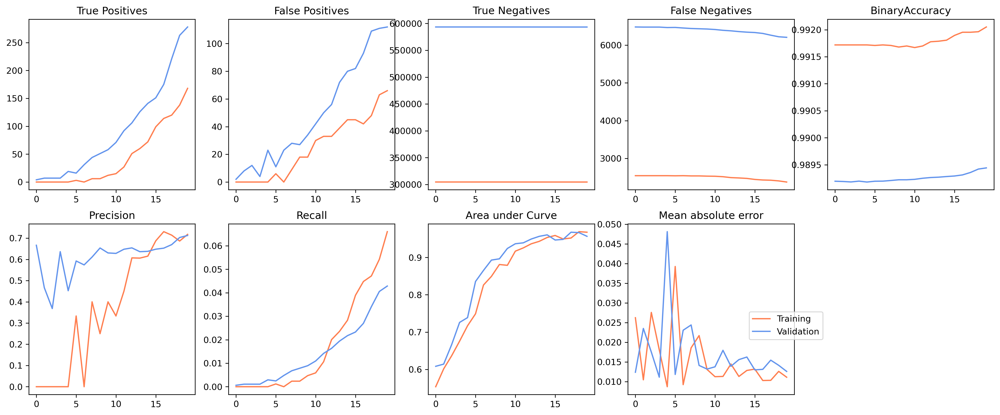

In [40]:
titleDict = {'tp': "True Positives",'fp': "False Positives",'tn': "True Negatives",'fn': "False Negatives", 'accuracy':"BinaryAccuracy",'precision': "Precision",'recall':"Recall",'auc': "Area under Curve", 'mae': "Mean absolute error"}

fig,ax = plt.subplots(2,5, figsize=(20,8), dpi=300)
ax =ax.ravel()
for idx,key in enumerate(titleDict.keys()): 
    ax[idx].plot(loss_history.epoch, loss_history.history[key], color='coral', label='Training')
    ax[idx].plot(loss_history.epoch, loss_history.history['val_'+key], color='cornflowerblue', label='Validation')
    ax[idx].set_title(titleDict[key]); 

ax[9].axis('off');
axLine, axLabel = ax[0].get_legend_handles_labels() # Take the lables and plot line information from the first panel
lines =[]; labels = []; lines.extend(axLine); labels.extend(axLabel);fig.legend(lines, labels, bbox_to_anchor=(0.7, 0.3), loc='upper left');

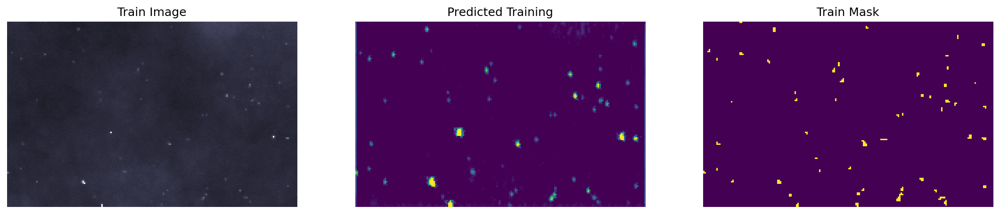

In [41]:
unet_train_pred = t_unet.predict(prep_img(train_img[:,wpos[1]:(wpos[1]+ww)]))[0, :, :, 0]

fig, m_axs = plt.subplots(1, 3, figsize=(18, 4), dpi=150); m_axs= m_axs.ravel(); 
for c_ax in m_axs: c_ax.axis('off')

m_axs[0].imshow(train_img[:,wpos[1]:(wpos[1]+ww)], cmap='bone', vmin=0, vmax=4000), m_axs[0].set_title('Train Image')
m_axs[1].imshow(unet_train_pred, cmap='viridis', vmin=0, vmax=0.2), m_axs[1].set_title('Predicted Training')
m_axs[2].imshow(train_mask[:,wpos[1]:(wpos[1]+ww)], cmap='viridis'), m_axs[2].set_title('Train Mask');


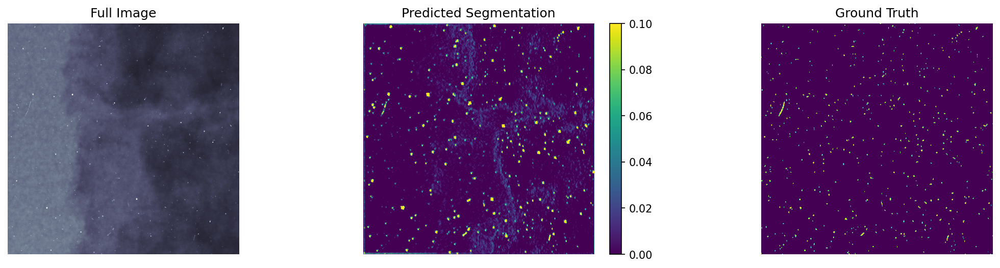

In [42]:
unet_pred = t_unet.predict(prep_img(forigc))[0, :, :, 0]

fig, m_axs = plt.subplots(1, 3, figsize=(18, 4), dpi=150); m_axs = m_axs.ravel() ; 
for c_ax in m_axs: c_ax.axis('off')
m_axs[0].imshow(forigc, cmap='bone', vmin=0, vmax=4000); m_axs[0].set_title('Full Image')
f1=m_axs[1].imshow(unet_pred, cmap='viridis', vmin=0, vmax=0.1); m_axs[1].set_title('Predicted Segmentation'); fig.colorbar(f1,ax=m_axs[1]);
m_axs[2].imshow(maskc,cmap='viridis'); m_axs[2].set_title('Ground Truth');

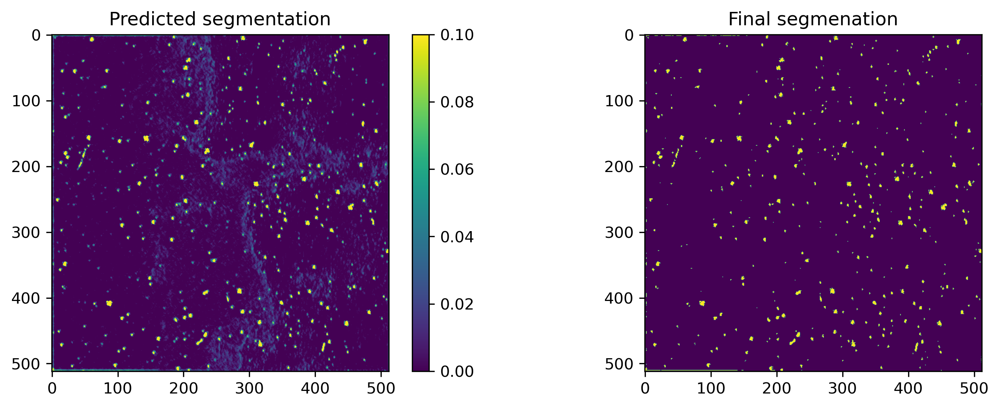

In [43]:
fig, ax = plt.subplots(1,2, figsize=(12,4))
ax0=ax[0].imshow(unet_pred, vmin=0, vmax=0.1); ax[0].set_title('Predicted segmentation'); fig.colorbar(ax0,ax=ax[0])
ax[1].imshow(0.05<unet_pred), ax[1].set_title('Final segmenation');

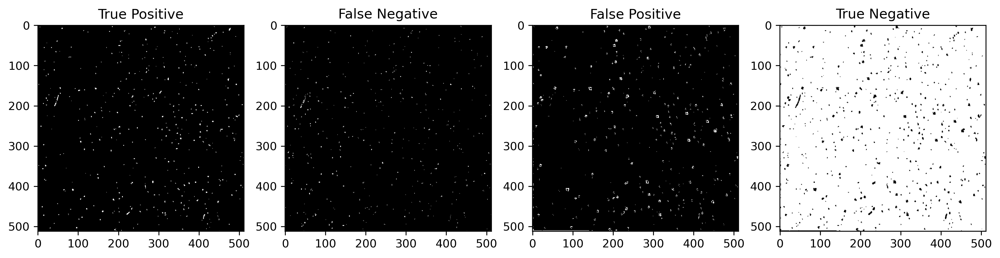

In [44]:
gt = maskc
pr = 0.05<unet_pred
ps.showHitCases(gt,pr,cmap='gray')

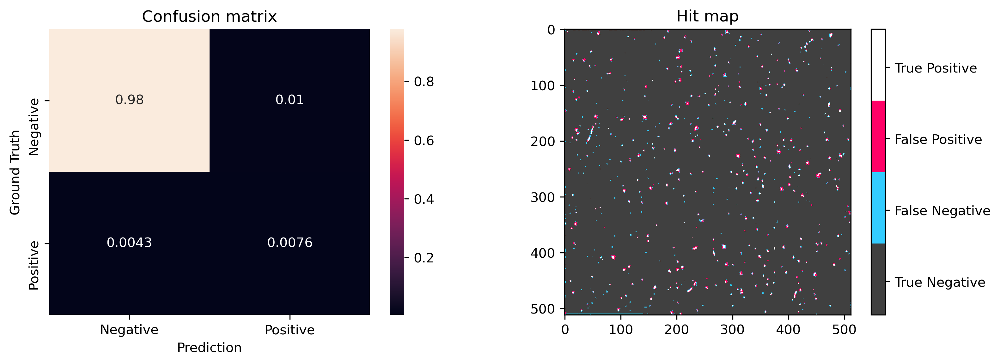

In [45]:
ps.showHitMap(gt,pr)
plt.savefig('spotunet.png')